# [TASK 5] EDA danych historycznych z Kaggle
## A. Inicjalizacja


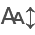

In [64]:
import pandas as pd
from pathlib import Path
from itables import init_notebook_mode
from pandas import json_normalize
import json
import numpy as np
import ast
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objects as go

init_notebook_mode(all_interactive=True)

PATH_2021_10 = Path('../data/archive/2021-10')
PATH_ARCHIV = Path('../data/archive')
PATH_DATA = Path('../data')

## B. Wczytanie i analiza danych z października 2021 roku

In [65]:
# Lista do przechowywania poszczególnych DataFrame'ów
dfs = []
for json_path in sorted(PATH_2021_10.glob("2021-10-*.json")):
    json_name = json_path.name
    print(f"Processing {json_name}")
    # Pobieranie danych z JSON
    with open(json_path, 'r', encoding='utf-8') as f:
        json_data = json.load(f)
        df = pd.DataFrame(json_data)
        dfs.append(df)
# Utworzenie df ze wszystkich dni w październiku (9 dni)
final_df = pd.concat(dfs, ignore_index=True)

Processing 2021-10-23.json
Processing 2021-10-24.json
Processing 2021-10-25.json
Processing 2021-10-26.json
Processing 2021-10-27.json
Processing 2021-10-28.json
Processing 2021-10-29.json
Processing 2021-10-30.json
Processing 2021-10-31.json


In [66]:
final_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60678 entries, 0 to 60677
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   title             60678 non-null  object
 1   street            60666 non-null  object
 2   city              60678 non-null  object
 3   country_code      60592 non-null  object
 4   address_text      60678 non-null  object
 5   marker_icon       60678 non-null  object
 6   workplace_type    60678 non-null  object
 7   company_name      60678 non-null  object
 8   company_url       60678 non-null  object
 9   company_size      60678 non-null  object
 10  experience_level  60678 non-null  object
 11  latitude          60678 non-null  object
 12  longitude         60678 non-null  object
 13  published_at      60678 non-null  object
 14  remote_interview  60678 non-null  bool  
 15  id                60678 non-null  object
 16  employment_types  60678 non-null  object
 17  company_logo

In [67]:
# Zmiana kolumn zawierających listy ze słownikami w stringi, żeby można było usunąc duplikaty
final_df[['employment_types', 'skills']] = final_df[['employment_types', 'skills']].apply(lambda x: x.astype(str))
# Usunięcie zbędnych kolumn
final_df = final_df.drop(['company_url', 'latitude', 'longitude', 'id','company_logo_url'], axis=1)

In [68]:
# Liczba wszystkich ofert
print(len(final_df))

60678


In [69]:
# Usunięcie duplikatów
final_df = final_df.drop_duplicates()

In [70]:
# Liczba unikatowych ofert z różnymi datami publikacji
print(len(final_df))

17578


In [71]:
# Zmiana formatu czasu w kolumnie 'published_at'
final_df['published_at'] = pd.to_datetime(final_df['published_at'])

In [72]:
# Utworzenie listy nazw kolumn z wyjątkiem 'published_at'
group_columns = list(final_df.columns[final_df.columns != 'published_at'])
# Sprawdzenie liczby unikatowych ofert
unique_offers = final_df.groupby(group_columns).ngroups
print(unique_offers)

8480


In [73]:
# Utworzenie df z unikatowymi ofertami z datą najstarszej publikacji
unique_offers_df = final_df.loc[final_df.groupby(group_columns)['published_at'].idxmin()]

In [74]:
# Sprawdzenie czasu publikacji nastarszej oferty
unique_offers_df['published_at'].min()

Timestamp('2021-09-20 09:01:00+0000', tz='UTC')

#### Wnioski
* W danych pobranych przez 9 kolejnych dni (23-31.10.2021 r.) znajduje się 60.678 ofert
* Wśród tych ofert znajduje się 8.480 unikatowych
* Najwcześniejsza data publikacji pobranych ofert, to 20.09.2021 r.
* W ciągu około 40 dni oferty zostały opublikowane 17.539 razy, czyli każda ponad 2 razy 
* Informacje opisujące oferty znajdują się w 20 kolumnach, z czego dwie są zagnieżdżone (5 kolumn nie zawiera istotnych danych)

## C. Wczytanie i analiza wszystkich danych
### 1. Przygotowanie pliku JSON zawierającego wszystkie istotne dane

In [ ]:
# Funkcja do przetwarzania JSON do DF
def load_json_to_dataframe(path):
    # Lista do przechowywania poszczególnych DataFrame
    dfs = []
    # Lista kolumn do usunięcia, w tym 3 ostatnie które pojawiają się z czasem w pobiernaych danych
    columns_to_drop = [
        'company_url', 'latitude', 'longitude', 'id', 'company_logo_url', 
        'multilocation', 'display_offer', 'way_of_apply'
    ]
    # Iterowanie po plikach JSON w archiwum
    for json_path in sorted(path.glob("*.json")):
        json_name = json_path.name
        print(f"Processing {json_name}")
        # Pobieranie danych z JSON
        with open(json_path, 'r', encoding='utf-8') as f:
            df = pd.read_json(f)
            # Usunięcie zbędnych kolumn, jeżeli istnieją
            df = df.drop(columns=[col for col in columns_to_drop if col in df.columns], errors='ignore')
            # Zmiana kolumn zawierających listy ze słownikami w stringi
            df[['employment_types', 'skills']] = df[['employment_types', 'skills']].apply(lambda x: x.astype(str))
            # Utworzenie listy nazw kolumn z wyjątkiem 'published_at'
            group_columns = [col for col in df.columns if col != 'published_at']
            # Zmiana formatu czasu w kolumnie 'published_at'
            df['published_at'] = pd.to_datetime(df['published_at']).dt.floor('s')
            # Utworzenie DF z unikatowymi ofertami z datą najstarszej publikacji
            df = df.sort_values(by='published_at')
            df = df.drop_duplicates(subset=group_columns, keep='first')
            print(f"Processed {len(df)} rows")
            # Dodawanie DF do listy
            dfs.append(df)

    return pd.concat(dfs, ignore_index=True) if dfs else pd.DataFrame()

# Funkcja do przetwarzania folderów w "kawałkach"
def process_folders_in_chunks(folders, chunk_size, output_path):
    chunk_number = 0
    # Tworzenie pętli, która przechodzi przez foldery w kawałkach
    for i in range(0, len(folders), chunk_size):
        chunk_number += 1
        folder_chunk = folders[i:i + chunk_size]
        # Przetwarzanie folderów w tym kawałku
        print(f"Processing chunk {chunk_number}...")
        dfs = []
        for folder in folder_chunk:
            print(f"Processing folder {folder.name}...")
            df = load_json_to_dataframe(folder)
            dfs.append(df)
        final_df = pd.concat(dfs, ignore_index=True)

        # Utworzenie listy nazw kolumn z wyjątkiem 'published_at'
        group_columns = [col for col in final_df.columns if col != 'published_at']
        # Utworzenie df z unikatowymi ofertami z datą najstarszej publikacji
        final_df = final_df.sort_values(by='published_at')
        final_df = final_df.drop_duplicates(subset=group_columns, keep='first')
        # Zapis DataFrame do pliku JSON
        output_file = output_path / f'justjoinit_archive_m_kij_{chunk_number}.json'
        final_df.to_json(output_file, index=False)
        print(f"Conversion to JSON for chunk {chunk_number} completed.")
    
    print("All JSON files processed and saved.")

# Pobieranie wszystkich folderów
folders = sorted(PATH_ARCHIV.glob("202*"))
chunk_size = 6
# Przetwarzanie folderów
process_folders_in_chunks(folders, chunk_size, PATH_DATA)
print("All JSON files ready.")

In [ ]:
dfs = []
# Wczytywanie i łączenie plików JSON w katalogu 'data'
for json_path in sorted(PATH_DATA.glob("justjoinit_archive_m_kij_*.json")):
    json_name = json_path.name
    print(f"Processing {json_name}")
    # Pobieranie danych z JSON
    with open(json_path, 'r', encoding='utf-8') as f:
        df = pd.read_json(f)
        # Dodawanie DF do listy
        dfs.append(df)
final_df = pd.concat(dfs, ignore_index=True) 

In [ ]:
# Utworzenie listy nazw kolumn z wyjątkiem 'published_at'
group_columns = [col for col in final_df.columns if col != 'published_at']
# Utworzenie DF z unikatowymi ofertami z datą najstarszej publikacji
final_df = final_df.sort_values(by='published_at')
final_df = final_df.drop_duplicates(subset=group_columns, keep='first')

In [ ]:
# Zapis DataFrame do pliku JSON
final_df.to_json(PATH_DATA / 'justjoinit_archive_all_m_kij.json', index=False)
print("Conversion to JSON completed.")

### 2. Wczytywanie pliku JSON zawierającego wszystkie istotne dane i wstępna analiza

In [75]:

# Pobieranie danych z JSON
with open(PATH_DATA / 'justjoinit_archive_all_m_kij.json', 'r', encoding='utf-8') as f:
    df = pd.read_json(f)
# Filtrowanie danych na podstawie lat
df_2021 = df[df['published_at'].dt.year == 2021]
df_2022 = df[df['published_at'].dt.year == 2022]
df_2023 = df[df['published_at'].dt.year == 2023]
    

|Wyjaśnienie nazw kolumn:| |
|------------------------|-|
| 1. `title` - nazwa stanowiska| 9. `company_size` - wielkość firmy|
| 2. `street` - ulica| 10. `experience_level` - poziom doświadczenia|
| 3. `city` - miasto/miejsce zatrudnienia|11. `published_at` - czas pierwszej publikacji oferty|
| 4. `country_code` - kod kraju|12. `remote_interview` - zdalna rekrutacja|
| 5. `address_text` - adres|13. `employment_types` - typ umowy i wynagrodzenie|
| 6. `marker_icon` - kategoria|14. `skills` - wymagane kompetencje|
| 7. `workplace_type` - rodzaj pracy (zdalna, częściowo zdalna, etc.)|15. `remote` - ?|
| 8. `company_name` - nazwa firmy poszukującej pracownika|16. `open_to_hire_ukrainians` - oferta dla Ukraińców|

In [76]:
df

title               street  \
0                             Frontend Developer         Sarmacka, 7J   
1                     Senior QA Engineer (m/f/d)         Domstraße 10   
2                            Front End Developer           Anson Road   
3                   PHP Senior Software Engineer           Anson Road   
4           Senior Backend PHP Developer (m/f/d)         Domstraße 10   
...                                          ...                  ...   
348774               Business (Software) Analyst         Puławska 182   
348775  Adiunkt, Ekspert ds. Obliczeń Kwantowych        ul. Kolska 12   
348776             Python backend game developer      Stępińska 22/30   
348777             Senior Test Engineer (mobile)         Puławska 182   
348778                               QA Engineer  aleje jerozolimskie   

             city country_code                   address_text marker_icon  \
0        Warszawa           PL         Sarmacka, 7J, Warszawa  javascript   
1         Hamburg           DE          Domstraße 10, Hamburg         php   
2       Singapore           SG          Anson Road, Singapore  javascript   
3       Singapore           SG          Anson Road, Singapore         php   
4         Hamburg           DE          Domstraße 10, Hamburg         php   
...           ...          ...                            ...         ...   
348774   Warszawa           PL         Puławska 182, Warszawa   analytics   
348775   Warszawa           PL        ul. Kolska 12, Warszawa       other   
348776   Warszawa           PL      Stępińska 22/30, Warszawa      python   
348777   Warszawa           PL         Puławska 182, Warszawa      mobile   
348778   Warszawa           PL  aleje jerozolimskie, Warszawa     testing   

       workplace_type           company_name company_size experience_level  \
0              remote              3D Estate          +40              mid   
1              remote  ABOUT YOU AG. & Co KG        15000           senior   
2              remote                 Triber          40+           senior   
3              remote                 Triber          40+           senior   
4              remote  ABOUT YOU AG & Co. KG        15000           senior   
...               ...                    ...          ...              ...   
348774         remote            Future Mind         180+              mid   
348775  partly_remote                   NASK        1000+           senior   
348776         remote               GameCode        15-20              mid   
348777         remote                     7N         800+           senior   
348778         remote                  Onoco         5-10              mid   

              published_at  remote_interview  \
0      2021-09-20 09:01:00              True   
1      2021-09-23 12:26:00              True   
2      2021-09-23 13:40:00              True   
3      2021-09-23 13:48:00              True   
4      2021-09-24 12:50:00              True   
...                    ...               ...   
348774 2023-09-25 15:25:46              True   
348775 2023-09-25 15:33:32              True   
348776 2023-09-25 15:36:55              True   
348777 2023-09-25 16:30:34             False   
348778 2023-09-25 16:44:18              True   

                                         employment_types  \
0       [{'type': 'b2b', 'salary': {'from': 12000, 'to...   
1                 [{'type': 'permanent', 'salary': None}]   
2       [{'type': 'permanent', 'salary': {'from': 1200...   
3       [{'type': 'permanent', 'salary': {'from': 1400...   
4                 [{'type': 'permanent', 'salary': None}]   
...                                                   ...   
348774  [{'type': 'b2b', 'salary': {'from': 12000, 'to...   
348775  [{'type': 'permanent', 'salary': {'from': 1500...   
348776  [{'type': 'b2b', 'salary': {'from': 15000, 'to...   
348777  [{'type': 'b2b', 'salary': {'from': 25200, 'to...   
348778  [{'type': 'b2b', 'salary': {'from': 7000, 'to'..

#### Wnioski
W pobranych danych znajduje się 300.095 unikatowych ofert pracy

### 3. Analiza rozkładu publikacji nowych ofert w czasie

In [77]:
# Utworzenie kolumny z rokiem i miesiącem
df['year_month'] = df['published_at'].dt.to_period('M')

# Grupowanie danych po 'year_month' i liczenie liczby ofert
monthly_counts = df.groupby('year_month').size().reset_index(name='offers_count')
monthly_counts['year_month'] = monthly_counts['year_month'].astype(str)

In [78]:
# Ilość publikowanych nowych ofert w kolejnych miesiącach
monthly_counts

year_month  offers_count
0     2021-09            26
1     2021-10          8620
2     2021-11          7363
3     2021-12          5784
4     2022-01          7638
5     2022-02         18785
6     2022-03         13373
7     2022-04         10807
8     2022-05         12587
9     2022-06         13069
10    2022-07         14653
11    2022-08         17343
12    2022-09         17194
13    2022-10         15521
14    2022-11         14065
15    2022-12          9096
16    2023-01         14409
17    2023-02         14110
18    2023-03         15332
19    2023-04         13124
20    2023-05         13467
21    2023-06         11263
22    2023-07         11220
23    2023-08         12044
24    2023-09          9202

In [ ]:
# Generowanie wykresu słupkowego
fig = px.bar(monthly_counts, x='year_month', y='offers_count', 
             title='Liczba publikowanych nowych ofert w każdym miesiącu', 
             labels={'year_month': 'Miesiąc', 'offers_count': 'Liczba ofert'},
             color='offers_count',
             color_continuous_scale='Turbo')
# Dodanie adnotacji przy lutym 2022
fig.add_annotation(
    x="2022-02",  
    y=monthly_counts[monthly_counts['year_month'] == '2022-02']['offers_count'].values[0],
    text="Początek wojny na Ukrainie",
    showarrow=True,
    arrowhead=2,
    ax=0,
    ay=-40,
    font=dict(size=12, color="red", family="Arial", weight="bold"),
    bgcolor="white",
)
fig.show()

In [ ]:
# Konwersja daty na datetime
df['published_at'] = pd.to_datetime(df['published_at'])
# Filtrowanie danych dla lutego 2022
df_february_2022 = df[(df['published_at'].dt.year == 2022) & (df['published_at'].dt.month == 2)]
# Grupowanie po dniu publikacji i liczbie ofert
df_grouped = df_february_2022.groupby(df_february_2022['published_at'].dt.date).size().reset_index(name='count')

# Generowanie wykresu
fig = px.bar(df_grouped, x='published_at', y='count', 
             labels={'published_at': 'Data', 'count': 'Liczba ofert'},
             title='Liczba ofert publikowanych w lutym 2022', 
             color='count', color_continuous_scale='Turbo')
fig.update_xaxes(
    tickmode='array',  
    tickvals=df_grouped['published_at'],  
    tickformat='%d-%m-%Y', 
    tickangle=45  
)
# Dodanie adnotacji dla 24 lutego 2022 - początek wojny na Ukrainie
fig.add_annotation(
    x='2022-02-24',  
    y=max(df_grouped['count']) * 1.05,  
    text="Początek wojny na Ukrainie", 
    showarrow=True, 
    arrowhead=2, 
    ax=0,  
    ay=-40, 
    font=dict(size=12, color="red", family="Arial", weight="bold"),
    bgcolor="white",  
    borderpad=4 
)

fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))  # Dodanie obramowania słupków
fig.show()



#### Wnioski
* Pobrane oferty były po raz pierwszy publikowane od września 2021 roku do września 2023 roku 
* Do rozpoczęcia wojny na Ukrainie ilość publikowanych miesięcznie ofert wynosiła 5-8 tysięcy
* Od początku wojny na Ukrainie nastąpił skokowy wzrost ilości publikowanych ofert do zakresu 9-17 tysięcy miesięcznie

### 4. Analiza brakujących danych

In [81]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 300095 entries, 0 to 348778
Data columns (total 17 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   title                    300095 non-null  object        
 1   street                   300063 non-null  object        
 2   city                     300095 non-null  object        
 3   country_code             299921 non-null  object        
 4   address_text             300095 non-null  object        
 5   marker_icon              300095 non-null  object        
 6   workplace_type           300095 non-null  object        
 7   company_name             300095 non-null  object        
 8   company_size             300095 non-null  object        
 9   experience_level         300095 non-null  object        
 10  published_at             300095 non-null  datetime64[ns]
 11  remote_interview         300095 non-null  bool          
 12  employment_types     

In [82]:
# Sprawdzenie ofert bez określonego 'country_code'
df[df['country_code'].isna()]

title                       street  \
357                 Service Delivery Coordinator           Stefana Batorego 8   
540                          Head of Engineering          Chmielna 73, 00-801   
690                  Młodszy specjalista ds. ERP            Armii Krajowej 51   
901                                PHP Team Lead                      Centrum   
4857    Full Stack Developer .Net Vue.js / React                   Kościuszki   
...                                          ...                          ...   
331477                             PHP Developer  Królowej Korony Polskiej 24   
332271               Administrator Cloud Regular            Jana Pawła II, 10   
332323               Administrator Cloud Regular            Jana Pawła II, 10   
332708                  Senior Software Engineer                  Fabryczna 5   
339560                Junior eCommerce Developer                  Domaniewska   

            city country_code                           address_text  \
357       Błonie         None             Stefana Batorego 8, Błonie   
540       Warsaw         None            Chmielna 73, 00-801, Warsaw   
690     Katowice         None            Armii Krajowej 51, Katowice   
901     Warszawa         None                      Centrum, Warszawa   
4857      Kraków         None                     Kościuszki, Kraków   
...          ...          ...                                    ...   
331477  Szczecin         None  Królowej Korony Polskiej 24, Szczecin   
332271    Poznań         None              Jana Pawła II, 10, Poznań   
332323    Poznań         None              Jana Pawła II, 10, Poznań   
332708  Warszawa         None                  Fabryczna 5, Warszawa   
339560  Warszawa         None                  Domaniewska, Warszawa   

         marker_icon workplace_type     company_name company_size  \
357            admin  partly_remote       BorgWarner        1500+   
540     architecture  partly_remote             Zing           30   
690              erp         office            Famur         300+   
901              php         remote           Jagaad           40   
4857             net  partly_remote        Frontiers         >700   
...              ...            ...              ...          ...   
331477           php         remote         Riotters           25   
332271         admin  partly_remote             PCSS         >300   
332323        python  partly_remote             PCSS         >300   
332708        python         remote  CloudFerro S.A.         200+   
339560           php  partly_remote        Star Hunt         1-10   

       experience_level        published_at  remote_interview  \
357              senior 2021-10-15 07:22:00              True   
540              senior 2021-10-15 14:45:00              True   
690              junior 2021-10-16 14:00:00             False   
901              senior 2021-10-17 14:00:00             False   
4857                mid 2021-10-21 13:01:00              True   
...                 ...                 ...               ...   
331477              mid 2023-08-09 14:25:00              True   
332271              mid 2023-08-11 10:47:00              True   
332323              mid 2023-08-11 11:23:00              True   
332708           senior 2023-08-14 08:47:00              True   
339560           junior 2023-09-01 08:15:00             False   

                                         employment_types  \
357               [{'type': 'permanent', 'salary': None}]   
540     [{'type': 'permanent', 'salary': {'from': 7000...   
690     [{'type': 'permanent', 'salary': {'from': 4500...   
901     [{'type': 'permanent', 'salary': {'from': 1600...   
4857    [{'type': 'b2b', 'salary': {'from': 17000, 'to...   
...                                                   ...   
331477  [{'type': 'b2b', 'salary': {'from': 10500, 'to...   
332271  [{'type': 'permanent', 'salary': {'from': 8000...   
332323  [{'type': 'permanent', 'salary': {'fro

In [83]:
# Sprawdzenie ilości ofert bez danych w kolumnie 'open_to_hire_ukrainians'
print(df['open_to_hire_ukrainians'].isna().sum())


37542


#### Wnioski
* W kolumnie 'street' w 32 ofertach brakuje danych, jednak nie jest to istotne, tym bardziej, że w kolumnie 'address_text' nie ma braków
* W kolumie 'country_code' w 174 ofertach brakuje danych i warto byłoby je uzupełnić
* W kolumnie 'open_to_hire_ukrainians' brakuje danych w 37.542 ofertach

### 5. Analiza pojedynczych zmiennych i transformacja danych
#### A. Tytuły ofert

In [84]:
# Sprawdzenie ilości unikatowych stanowisk pracy
df['title'].nunique()

33882

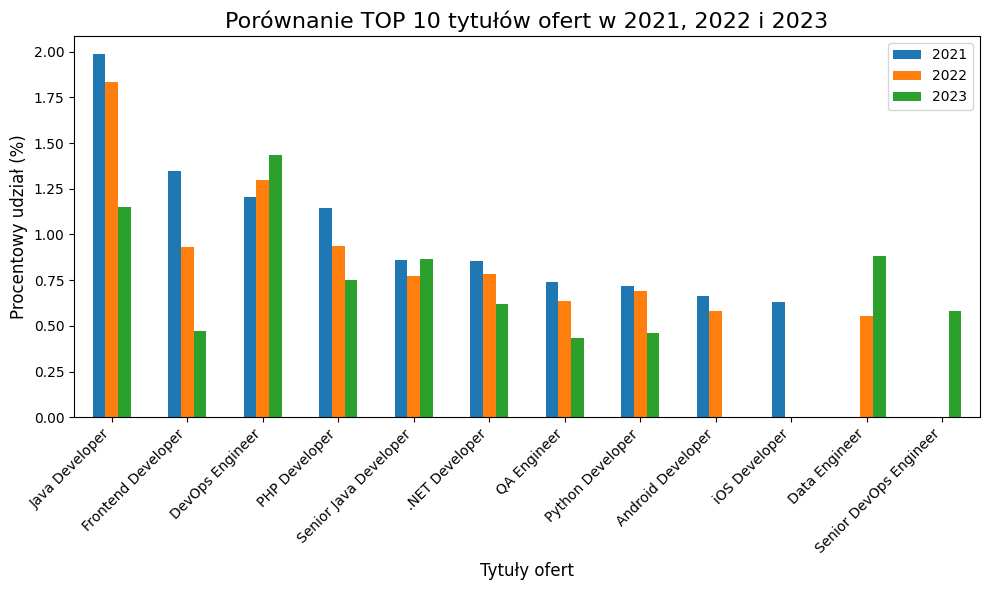

In [85]:

# TOP 10 TYTUŁÓW OFERT PRACY
# Obliczanie procentów dla top 10 tytułów ofert w każdym roku
top_10_2021 = df_2021['title'].value_counts(normalize=True).head(10) * 100
top_10_2022 = df_2022['title'].value_counts(normalize=True).head(10) * 100
top_10_2023 = df_2023['title'].value_counts(normalize=True).head(10) * 100

# Utworzenie DF do wykresu
top_10_df = pd.DataFrame({
    '2021': top_10_2021,
    '2022': top_10_2022,
    '2023': top_10_2023
}).fillna(0)  # Uzupełnianie brakujących wartości zerami

# Sortowanie danych malejąco według wartości z 2021 roku
top_10_df = top_10_df.sort_values(by='2021', ascending=False)

# Generowanie wykresu słupkowego
ax = top_10_df.plot(kind='bar', figsize=(10, 6), color=['#1f77b4', '#ff7f0e', '#2ca02c'])
ax.set_title('Porównanie TOP 10 tytułów ofert w 2021, 2022 i 2023', fontsize=16)
ax.set_xlabel('Tytuły ofert', fontsize=12)
ax.set_ylabel('Procentowy udział (%)', fontsize=12)
ax.set_xticklabels(top_10_df.index, rotation=45, ha='right')
plt.tight_layout()
plt.show()

#### Wnioski
* W ofertach znajdują się prawie 34.000 unikatowych tytułów ofert
* Wśród TOP 10 w latach 2021-2023, 8 tytułów pozostaje niezmiennych, jak Java Developer, Frontend Developer i DevOps Engineer
* Większość tytułów ofert występuje coraz rzadziej z wyjątkiem czterech:
    * Senior Java Developer (trend stabilny) 
    * DevOps Engineer (trend rosnący)
    * Data Engineer (trend rosnący)
    * Senior DevOps Engineer (trend rosnący)

#### B. Miasta / miejsca pracy

In [86]:
# Sprawdzenie ilości unikatowych miast / miejsc pracy
df['city'].nunique()

1652

In [ ]:
# Sprawdzenie częstości występowania nazw miast
city_percentage = df['city'].value_counts(normalize=True) * 100
df['city'].value_counts(normalize=True) * 100

city
Warszawa        20.605475
Kraków          11.875240
Wrocław         11.794932
Gdańsk           6.899482
Poznań           6.470284
                  ...    
Wodnica          0.000333
Modła            0.000333
Nowe Brzesko     0.000333
Dojazdów         0.000333
Kłomnice         0.000333
Name: proportion, Length: 1652, dtype: float64

In [88]:
# Przygotowanie danych do wykresu
# Zbieranie kategorii, które mają mniej niż 2,5%
other_city = city_percentage[city_percentage < 2.5].sum()
# Filtracja kategorii, które mają więcej niż 2,5%
city_percentage = city_percentage[city_percentage >= 2.5]
# Dodanie kategorii "inne" do reszty
city_percentage['inne'] = other_city

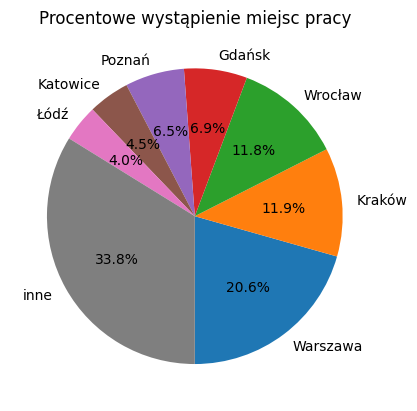

In [89]:
# Generowanie wykresu kołowego
plt.pie(city_percentage, labels=city_percentage.index, autopct='%1.1f%%', startangle=270)
plt.title('Procentowe wystąpienie miejsc pracy')
plt.show()

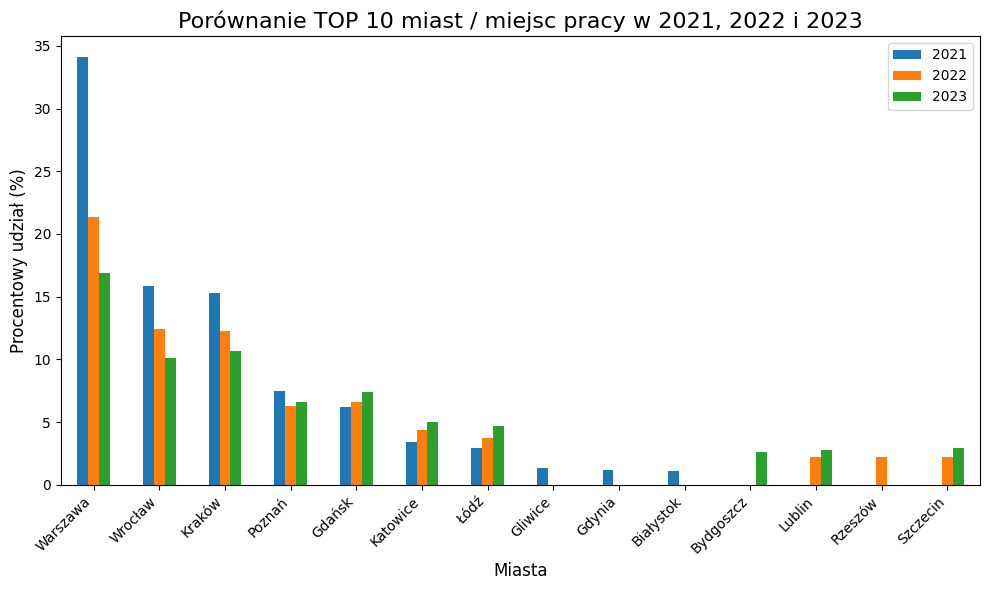

In [144]:
# TOP 10 MIAST / MIEJSC PRACY
# Obliczanie procentów dla top 10 miast / miejsc pracy
top_10_2021 = df_2021['city'].value_counts(normalize=True).head(10) * 100
top_10_2022 = df_2022['city'].value_counts(normalize=True).head(10) * 100
top_10_2023 = df_2023['city'].value_counts(normalize=True).head(10) * 100

# Utworzenie DF do wykresu
top_10_df = pd.DataFrame({
    '2021': top_10_2021,
    '2022': top_10_2022,
    '2023': top_10_2023
}).fillna(0)  # Uzupełnianie brakujących wartości zerami

# Sortowanie danych malejąco według wartości z 2021 roku
top_10_df = top_10_df.sort_values(by='2021', ascending=False)

# Generowanie wykresu słupkowego
ax = top_10_df.plot(kind='bar', figsize=(10, 6), color=['#1f77b4', '#ff7f0e', '#2ca02c'])
ax.set_title('Porównanie TOP 10 miast / miejsc pracy w 2021, 2022 i 2023', fontsize=16)
ax.set_xlabel('Miasta', fontsize=12)
ax.set_ylabel('Procentowy udział (%)', fontsize=12)
ax.set_xticklabels(top_10_df.index, rotation=45, ha='right')
plt.tight_layout()
plt.show()

#### Wnioski
* W ofertach znajdują się 1.652 miasta / miejsca pracy
* W ofertach najczęściej pojawia się Warszawa - 20%, Kraków i Wrocław - po 11%, Gdańsk i Poznań - po 6%
* Wśród TOP 10 w latach 2021-2023, 7 miast pozostaje niezmiennych jak Warszawa, Wrocław i Kraków 
* 4 miasta z czołówki: Warszawa, Wrocław, Kraków i Poznań pojawiają sie w ofertach coraz rzadziej
* W TOP 10 coraz częściej pojawiają sie oferty w Gdańsku, Katowicach, Łodzi, Lublinie i Szczecinie

#### C. Kraj / kod kraju

In [91]:
# Słownik z krajami przypisanymi do listy miast
countries = {
    'PL': ['Błonie', 'Warsaw', 'Katowice', 'Warszawa','Kraków', 'Poznań', 'Poznan', 'Wrocław', 'Zielona Góra', 'Lublin',
            'Szczecin', 'Łódź', 'Gdańsk', 'wrocław', 'Opole', 'Oława', 'Toruń', 'Legnica', 'Białystok', 
            'Gorzów Wielkopolski', 'Olsztyn', 'Rzeszów', 'Gliwice'],
    'DE': ['Munich', 'Berlin', 'Hamburg'],
    'GB': ['London', 'Manchester'],
    'RO': ['Bukareszt', 'Kluż-Napoka'],
    'ES': ['Madryt', 'Barcelona'],
    'NL': ['Amsterdam'],
    'CH': ['Zurych'],
    'CY': ['Limassol'],
    'AT': ['Wiedeń'],
    'AM': ['Erywań'],
    'HU': ['Budapeszt'],
    'UA': ['Lwów', 'Kijów'],
    'CZ': ['Praga'],
    'SK': ['Bratysława'],
    'LT': ['Wilno'],
    'PT': ['Lizbon'],
    'XK': ['Prisztina']
}
# Zamiana kluczy z wartościami
city_to_country = {}
for country, cities in countries.items():
    for city in cities:
        city_to_country[city] = country
# Wpisanie kodu państw na podstawie nazw miast
df['country_code'] = df.apply(lambda row: city_to_country[row['city']] if pd.isna(row['country_code']) and row['city'] in city_to_country else row['country_code'], axis=1)
# Sprawdzenie ofert bez kodu państwa
df[df['country_code'].isna()] 

title   street            city  \
5543                   DevOps Engineer: Database   Europe          Europe   
107189     Security Engineer - Incident Response  Centrum  European Union   
107193        Senior Machine Learning Researcher  Centrum  European Union   
118755                Senior Engineering Manager  Centrum  European Union   
118767  Senior Software Engineer CodeQL Platform  Centrum  European Union   
154242                   Senior Python Developer        -          Dniepr   
293868          ServiceNow - Developer/Architect   Europe          Europe   
294740                  Chief Technology Officer   Europe          Europe   

       country_code             address_text marker_icon workplace_type  \
5543           None           Europe, Europe      devops  partly_remote   
107189         None  Centrum, European Union    security         remote   
107193         None  Centrum, European Union       other         remote   
118755         None  Centrum, European Union       other         remote   
118767         None  Centrum, European Union    security         remote   
154242         None                -, Dniepr      python         remote   
293868         None           Europe, Europe       other         remote   
294740         None           Europe, Europe        ruby         remote   

       company_name company_size experience_level        published_at  \
5543    TRANSPOREON          120              mid 2021-10-22 08:08:00   
107189      Mozilla         100+              mid 2022-06-28 01:42:38   
107193       Github         100+           senior 2022-06-28 02:47:29   
118755       Github         100+           senior 2022-07-20 08:49:00   
118767       Github         100+           senior 2022-07-20 09:01:00   
154242  Infermedica          200           senior 2022-09-23 09:28:00   
293868  Mpower Plus          200              mid 2023-05-10 16:12:57   
294740  PeopleForce          >60           senior 2023-05-12 09:48:00   

        remote_interview                                   employment_types  \
5543               False            [{'type': 'permanent', 'salary': None}]   
107189              True                  [{'type': 'b2b', 'salary': None}]   
107193              True                  [{'type': 'b2b', 'salary': None}]   
118755              True                  [{'type': 'b2b', 'salary': None}]   
118767              True                  [{'type': 'b2b', 'salary': None}]   
154242              True                  [{'type': 'b2b', 'salary': None}]   
293868              True                  [{'type': 'b2b', 'salary': None}]   
294740             False  [{'type': 'b2b', 'salary': {'from': 9000, 'to'...   

                                                   skills  remote  \
5543    [{'name': 'PostgreSQL', 'level': 4}, {'name': ...   False   
107189                 [{'name': 'Security', 'level': 3}]    True   
107193                      [{'name': 'NLP', 'level': 3}]    True   
118755  [{'name': 'Communication', 'level': 4}, {'name...    True   
118767  [{'name': 'CodeQL', 'level': 4}, {'name': 'Pro...    True   
154242  [{'name': 'PostgreSQL', 'level': 4}, {'name': ...    True   
293868               [{'name': 'ServiceNow', 'level': 1}]    True   
294740  [{'name': 'Agile', 'level': 3}, {'name': 'AWS'...    True   

        open_to_hire_ukrainians year_month  
5543                        NaN    2021-10  
107189                      0.0    2022-06  
107193                      0.0    2022-06  
118755                      0.0    2022-07  
118767                      0.0    2022-07  
154242                      1.0    2022-09  
293868                      1.0    2023-05  
294740                      1.0    2023-05

In [92]:
# Słownik z poprawkami do kodów krajów
countries = {
    'Polska': 'PL',
    'UK': 'GB',
    'pl': 'PL',
}
# Wprowadzenie korekty do kodów krajów
df['country_code'] = df['country_code'].apply(lambda x: countries.get(x, x))

In [93]:
# Sprawdzenie ilości unikatowych kodów państw
df['country_code'].nunique()

87

In [94]:
# Rozkład procentowy krajów pochodzenia ofert
df['country_code'].value_counts(normalize=True) * 100

country_code
PL    97.090510
DE     0.482193
GB     0.333903
US     0.287583
CZ     0.180614
        ...    
CR     0.000333
CL     0.000333
GI     0.000333
QA     0.000333
UY     0.000333
Name: proportion, Length: 87, dtype: float64

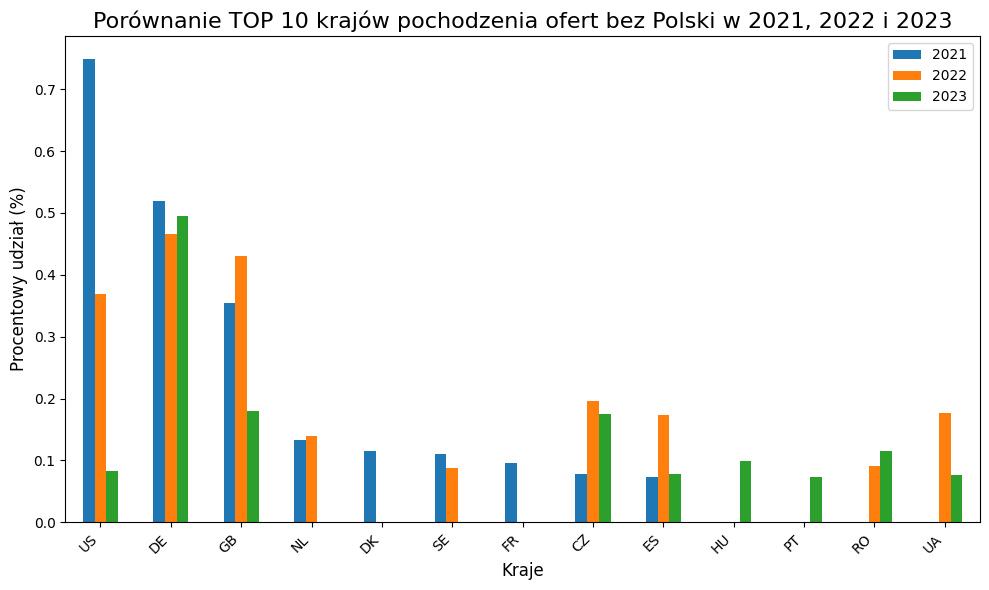

In [95]:
# TOP 10 krajów pochodzenia ofert z wyłaczeniem Polski
# Obliczanie procentów dla top 10 krajów w każdym roku
top_10_2021 = df_2021['country_code'].value_counts(normalize=True).head(10) * 100
top_10_2022 = df_2022['country_code'].value_counts(normalize=True).head(10) * 100
top_10_2023 = df_2023['country_code'].value_counts(normalize=True).head(10) * 100

# Utworzenie DF do wykresu
top_10_df = pd.DataFrame({
    '2021': top_10_2021,
    '2022': top_10_2022,
    '2023': top_10_2023
}).fillna(0)  # Uzupełnianie brakujących wartości zerami

# Sortowanie danych malejąco według wartości z 2021 roku
top_10_df = top_10_df.sort_values(by='2021', ascending=False)
# Wyłączenie Polski dla lepszego pokazania innych krajów
top_10_df = top_10_df.iloc[1:]

# Generowanie wykresu słupkowego
ax = top_10_df.plot(kind='bar', figsize=(10, 6), color=['#1f77b4', '#ff7f0e', '#2ca02c'])
ax.set_title('Porównanie TOP 10 krajów pochodzenia ofert bez Polski w 2021, 2022 i 2023', fontsize=16)
ax.set_xlabel('Kraje', fontsize=12)
ax.set_ylabel('Procentowy udział (%)', fontsize=12)
ax.set_xticklabels(top_10_df.index, rotation=45, ha='right')
plt.tight_layout()
plt.show()

#### Wnioski
* Oferty pochodzą z 87 róznych krajów
* Zdecydowana większość ofert pracy pochodzi z Polski - 97%
* Wśród pozostałych krajów najwięcej ofert pochodzi z Niemiec 0,48%, UK - 0,33% i USA - 0,29%
* Kraje z TOP 10 z których jest coraz więcej ofert, to Rumunia, Węgry i Portugalia

#### D. Kategorie ofert pracy

In [96]:
# Sprawdzenie ilości unikatowych kategorii ofert
df['marker_icon'].nunique()

24

In [97]:
# Rozkład procentowy kategorii ofert
marker_percentage = df['marker_icon'].value_counts(normalize=True) * 100
df['marker_icon'].value_counts(normalize=True) * 100

marker_icon
javascript      14.261817
java            10.502008
testing          7.001116
net              6.800513
devops           6.705210
data             6.072077
pm               5.000750
python           4.979756
php              4.846132
mobile           4.183675
admin            3.926090
analytics        3.610190
support          3.412586
other            3.101351
c                3.066362
architecture     3.003715
erp              2.130325
ux               1.849748
security         1.814425
ruby             1.148303
go               0.821740
game             0.686783
html             0.663790
scala            0.411536
Name: proportion, dtype: float64

In [98]:
# Przygotowanie danych do wykresu
# Zbieranie kategorii, które mają mniej niż 5%
other_marker = marker_percentage[marker_percentage < 5].sum()
# Filtracja kategorii, które mają więcej niż 2,5%
marker_percentage = marker_percentage[marker_percentage >= 5]
# Dodanie kategorii "inne" do reszty
marker_percentage['inne'] = other_marker

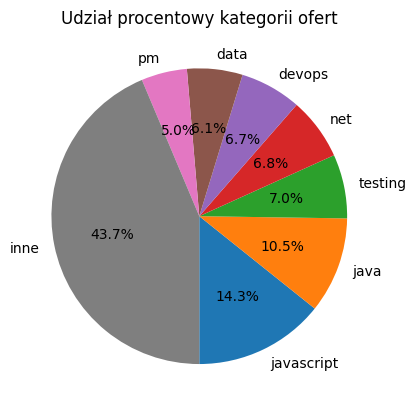

In [99]:
# Generowanie wykresu kołowego
plt.pie(marker_percentage, labels=marker_percentage.index, autopct='%1.1f%%', startangle=270)
plt.title('Udział procentowy kategorii ofert')
plt.show()

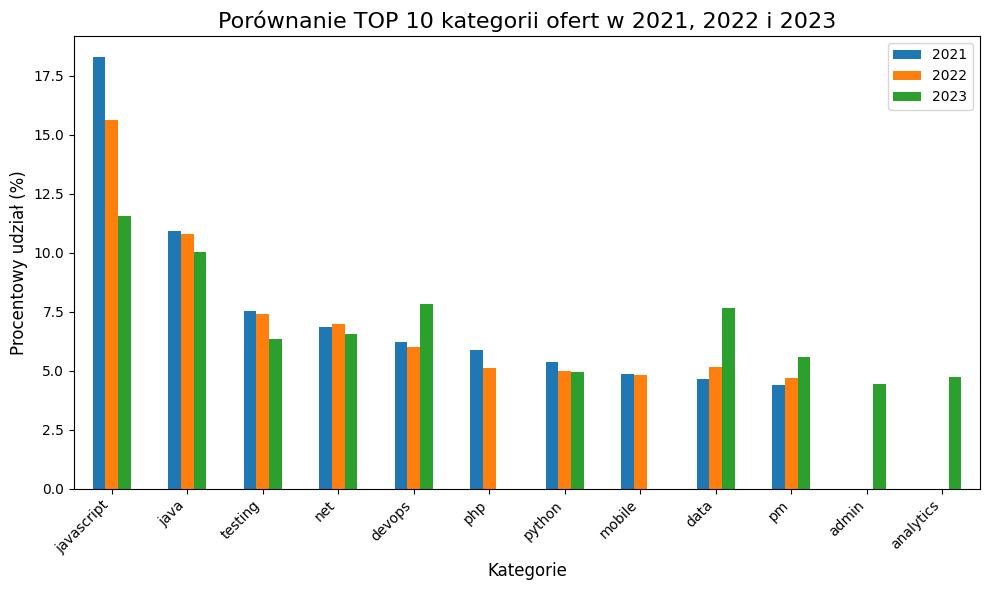

In [100]:
# TOP 10 kategorii ofert
# Obliczanie procentów dla top 10 kategorii ofert
top_10_2021 = df_2021['marker_icon'].value_counts(normalize=True).head(10) * 100
top_10_2022 = df_2022['marker_icon'].value_counts(normalize=True).head(10) * 100
top_10_2023 = df_2023['marker_icon'].value_counts(normalize=True).head(10) * 100

# Utworzenie DF do wykresu
top_10_df = pd.DataFrame({
    '2021': top_10_2021,
    '2022': top_10_2022,
    '2023': top_10_2023
}).fillna(0)  # Uzupełnianie brakujących wartości zerami

# Sortowanie danych malejąco według wartości z 2021 roku
top_10_df = top_10_df.sort_values(by='2021', ascending=False)

# Generowanie wykresu słupkowego
ax = top_10_df.plot(kind='bar', figsize=(10, 6), color=['#1f77b4', '#ff7f0e', '#2ca02c'])
ax.set_title('Porównanie TOP 10 kategorii ofert w 2021, 2022 i 2023', fontsize=16)
ax.set_xlabel('Kategorie', fontsize=12)
ax.set_ylabel('Procentowy udział (%)', fontsize=12)
ax.set_xticklabels(top_10_df.index, rotation=45, ha='right')
plt.tight_layout()
plt.show()

#### Wnioski
* Oferty klasyfikowane są do 24 unikatowych kategorii
* Oferty klasyfikowane są najczęściej do javascript - 14%, java - 11% i testing - 7%
* Spośród TOP 10 kategorii 7 występuje coraz rzadziej w tym 3 występujące najczęściej
* W TOP 10 coraz częściej pojawiają się devops, data, pm oraz admin i analytics

#### E. Rodzaj pracy

In [101]:
# Sprawdzenie ilości unikatowych rodzajów pracy
df['workplace_type'].nunique()

3

In [102]:
# Sprawdzenie częstości występowania rodzajów pracy
workplace_percentages = df['workplace_type'].value_counts(normalize=True) * 100
df['workplace_type'].value_counts(normalize=True) * 100     

workplace_type
remote           73.815292
partly_remote    23.027041
office            3.157667
Name: proportion, dtype: float64

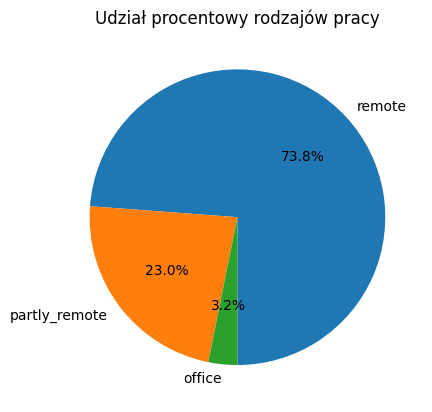

In [103]:
# Generowanie wykresu kołowego
plt.pie(workplace_percentages, labels=workplace_percentages.index, autopct='%1.1f%%', startangle=270)
plt.title('Udział procentowy rodzajów pracy')
plt.show()

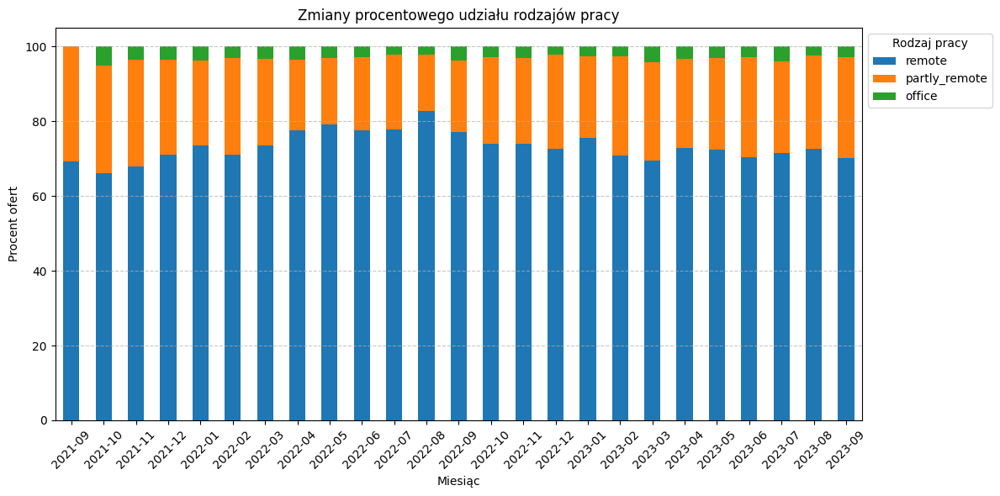

In [ ]:
# Przygotowanie danych do wykresu zmian w czasie
# Zliczenie każdego rodzaju pracy w miesiącach
df_grouped = df.groupby(['year_month', 'workplace_type']).size().unstack(fill_value=0)
# Obliczenie procentów dla każdego miesiąca
df_percentage = df_grouped.div(df_grouped.sum(axis=1), axis=0) * 100
# Odwrócenie kolejności kolumn, aby największe wartości były na dole
df_percentage = df_percentage[df_percentage.columns[::-1]]

# Generowanie wykresu
df_percentage.plot(kind='bar', stacked=True, figsize=(12, 6))
plt.title('Zmiany procentowego udziału rodzajów pracy')
plt.xlabel('Miesiąc')
plt.ylabel('Procent ofert')
plt.xticks(rotation=45)
plt.legend(title='Rodzaj pracy', bbox_to_anchor=(1, 1), loc='upper left')
plt.grid(True, axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


#### Wnioski
* Najczęściej występującym rodzajem pracy w ofertach jest praca zdalna -74%
* Praca częściowo zdalna występuje w 23% wszystkich ofert a praca biurowa w 3% 
* Udział procentowy rodzajów pracy w ofertach w kolejnych miesiącach pozostaje mniej więcej ten sam

#### F. Nazwa firmy

In [105]:
# Sprawdzenie ilości unikatowych nazw firm
df['company_name'].nunique()

7679

In [106]:
# Sprawdzenie częstości ogłaszania ofert
df['company_name'].value_counts(normalize=True) * 100

company_name
7N                    0.786418
Nokia                 0.703444
WIPRO                 0.602143
Boldare               0.593479
Volvo Polska          0.564821
                        ...   
MAIN Kube             0.000333
Pivotal Solutions     0.000333
Softvoya              0.000333
Dotfusion sp zo.o.    0.000333
Gülermak              0.000333
Name: proportion, Length: 7679, dtype: float64

#### Wnioski
* Analizowane oferty pochodziły od 7.679 firm
* Najwięcej ofert pochodziło od firm: 7N - 0,8%, Nokia - 0,7% i WIPRO - 0,6%

#### G. Wielkość firmy

In [107]:
# Sprawdzenie ilości unikatowych określeń wielkości firmy
df['company_size'].nunique()

1108

In [ ]:
# Funkcja standaryzująca ilość zatrudnionych
def standardize_company_size(size):
    if not isinstance(size, str) or not size.strip():
        return np.nan  # Obsługa wartości pustych lub niebędących stringami

    size = size.replace(' ', '').replace(',', '').strip()  # Usuwamy spacje i przecinki

    # Obsługa przypadku z podwójnym '++', np. '100++'
    if '++' in size:
        clean_size = size.replace('++', '')  # Usuwamy podwójne '+' na końcu
        if clean_size.isdigit():
            return int(clean_size)
        
    # Obsługa wartości '+- 100' lub '+-100' (traktujemy to jako wartość 100)
    if '+-' in size:
        clean_size = size.replace('+-', '')  # Usuwamy '+-' i traktujemy pozostałą część jako liczbę
        if clean_size.isdigit():
            return int(clean_size)  
    
    # Definiujemy zestaw znaków, do usunięcia
    valid_suffixes = ('+', '<', '>', '-')
    # Obsługa wartości z niepotrzebnymi znakami na końcu
    if size.endswith(valid_suffixes):
        clean_size = size[:-1]  # Usuwamy ostatni znak
        clean_size = clean_size.replace('.', '') # Usuwamy ewentualną kropkę
        if clean_size.isdigit():
            return int(clean_size)  
    
    # Obsługa wartości z niepotrzebnymi znakami na początku
    if size.startswith(valid_suffixes):
        clean_size = size[1:]  # Usuwamy pierwszy znak
        clean_size = clean_size.replace('.', '') # Usuwamy ewentualną kropkę
        if clean_size.isdigit():
            return int(clean_size)
   
    # Obsługa wartości w formacie '20-30', gdzie obliczamy średnią
    if '-' in size:
        parts = size.split('-')
        if len(parts) == 2:
            try:
                lower = int(parts[0])
                upper = int(parts[1])
                return (lower + upper) / 2  # Zwracamy średnią
            except ValueError:
                return np.nan  # W przypadku, gdy nie uda się przekonwertować na int

    # Obsługa wartości pojedynczych, np. '500.000', '3.700' z ewentualna kropką
    if size.replace('.', '').isdigit():
        return int(size.replace('.', ''))

    return np.nan  # Jeśli nic nie pasuje, zwracamy NaN

# Funkcja klasyfikująca firmy do odpowiednich kategorii wielkości
def classify_companies(size):
    if pd.isna(size):
        return 'Inne'
    elif size <= 10:
        return 'Małe'
    elif 10 < size <= 100:
        return 'Średnie'
    elif 100 < size <= 1000:
        return 'Duże'
    else:
        return 'Wielkie'


# Unifikowanie wielkości firm
df["standardized_size"] = df["company_size"].apply(standardize_company_size)

# Klasyfikacja firm na podstawie ich wielkości
df["company_class"] = df["standardized_size"].apply(classify_companies)

In [109]:
# Sprawdzenie częstości występowania ofert od firm różnej wielkości
company_class_percentages = df['company_class'].value_counts(normalize=True) * 100
df['company_class'].value_counts(normalize=True) * 100 

company_class
Duże       40.348556
Średnie    37.397158
Wielkie    18.433163
Małe        3.782802
Inne        0.038321
Name: proportion, dtype: float64

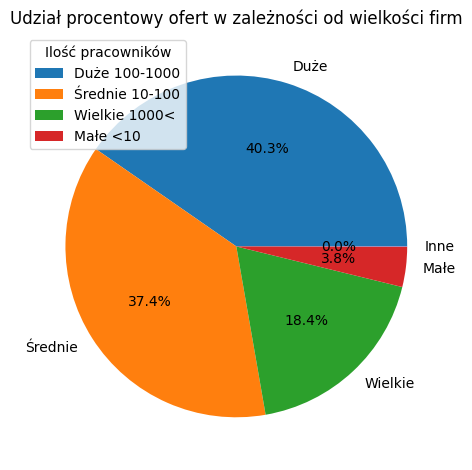

In [110]:
# Generowanie wykresu kołowego
plt.pie(company_class_percentages, labels=company_class_percentages.index, autopct='%1.1f%%', startangle=0)
plt.title('Udział procentowy ofert w zależności od wielkości firm')
legend_labels = ['Duże 100-1000', 'Średnie 10-100', 'Wielkie 1000<', 'Małe <10']
plt.legend(legend_labels, title="Ilość pracowników", loc="upper left")
plt.tight_layout()
plt.show()

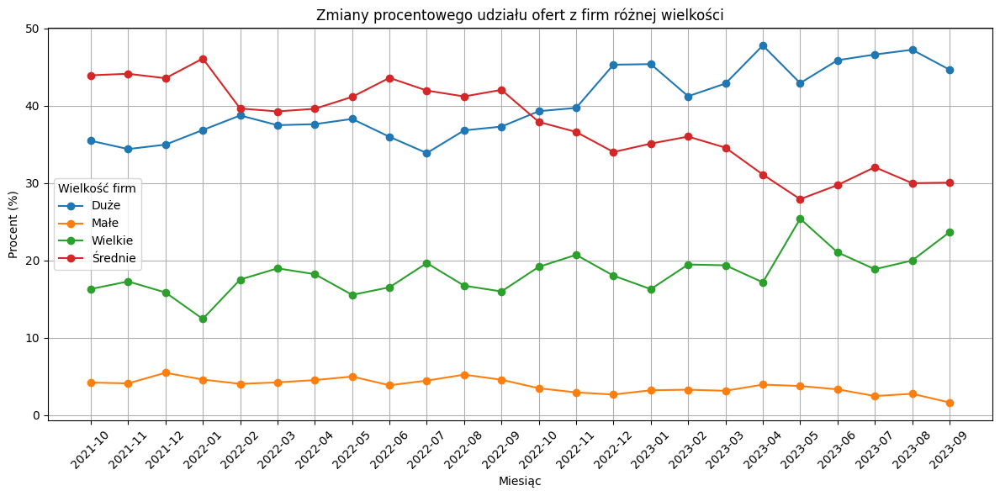

In [ ]:
# Przygotowanie danych do wykresu zmian w czasie
# Pominięcie pierwszego "szczątkowego" miesiąca - 2021-09
df_filtered = df[df['year_month'] != '2021-09']
# Zliczenie każdego rodzaju ofert w miesiącach
grouped = df_filtered.groupby([df_filtered['year_month'], 'company_class']).size().unstack(fill_value=0)
# Obliczanie procentów
percentages = grouped.div(grouped.sum(axis=1), axis=0) * 100
# Generowanie wykresu
plt.figure(figsize=(12, 6))
for col in percentages.columns:
    if col != 'Inne':  # Pomijanie kategorii "Inne" na wykresie
        plt.plot(percentages.index.astype(str), percentages[col], label=col, marker='o')

plt.xlabel('Miesiąc')
plt.ylabel('Procent (%)')
plt.title('Zmiany procentowego udziału ofert z firm różnej wielkości')
plt.legend(title='Wielkość firm')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

#### Wnioski
* Najwięcej - 40% ofert pracy pochodzi z firm Dużych, czyli zatrudniających od 100 do 1000 pracowników
* Dalsze 37% ofert pochodzi z firm Średnich, czyli zatrudniających od 10 do 100 pracowników
* Firmy Wielkie, czyli zatrudniające powyżej 1000 praconików odpowiadają za 18% ofert
* Małe firmy, zatrudniające do 10 pracowników, odpowiadają jedynie za okołóo 4% ofert
* W analizowanym okresie wzrastał procentowy udział ofert firm Dużych i Wielkich a spadał Średnich i Małych

#### H. Poziom doświadczenia

In [112]:
# Sprawdzenie ilości unikatowych poziomów doświadczenia
df['experience_level'].nunique()

3

In [113]:
# Sprawdzenie częstości występowania poziomów doświadczenia
experiencelevel_percentage = df['experience_level'].value_counts(normalize=True) * 100
df['experience_level'].value_counts(normalize=True) * 100

experience_level
mid       53.076859
senior    39.206918
junior     7.716223
Name: proportion, dtype: float64

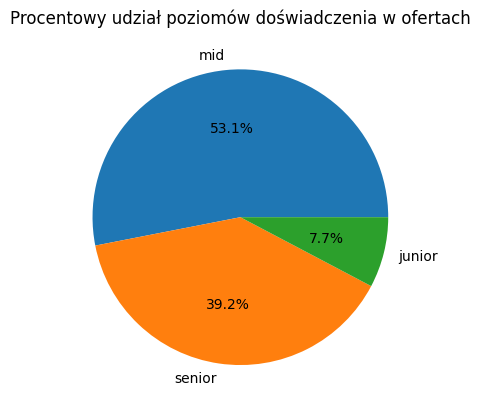

In [114]:
# Generowanie wykresu kołowego
plt.pie(experiencelevel_percentage, labels=experiencelevel_percentage.index, autopct='%1.1f%%', startangle=0)
plt.title('Procentowy udział poziomów doświadczenia w ofertach')
plt.show()

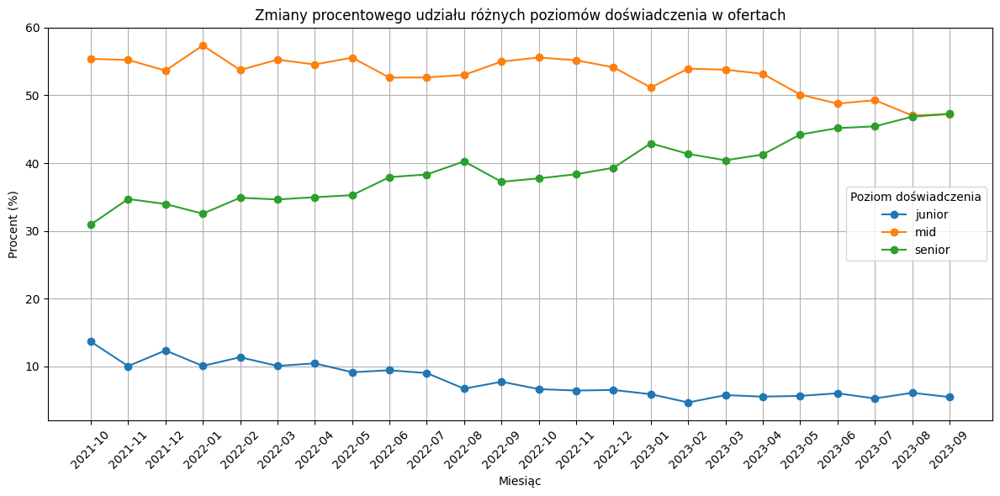

In [ ]:
# Przygotowanie danych do wykresu zmian w czasie
# Pominięcie pierwszego "szczątkowego" miesiąca - 2021-09
df_filtered = df[df['year_month'] != '2021-09']
# Zliczenie każdego rodzaju poziomu doświadczenia w miesiącach
grouped = df_filtered.groupby([df_filtered['year_month'], 'experience_level']).size().unstack(fill_value=0)

# Obliczanie procentów
percentages = grouped.div(grouped.sum(axis=1), axis=0) * 100

# Generowanie wykresu
plt.figure(figsize=(12, 6))
for col in percentages.columns:
    plt.plot(percentages.index.astype(str), percentages[col], label=col, marker='o')

plt.xlabel('Miesiąc')
plt.ylabel('Procent (%)')
plt.title('Zmiany procentowego udziału różnych poziomów doświadczenia w ofertach')
plt.legend(title='Poziom doświadczenia')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

#### Wnioski
* Najwięcej ofert dotyczy poziomu doświadczenia mid - 53%, następnie senior - 39% i w końcu junior - prawie 8%
* W analizowanym okresie wzrastał procentowy udział ofert na poziomie senior, aż zrównał się z poziomem mid, którego udział się zmniejszał
* Udział procentowy ofert dotyczących poziomu junior zmniejszył się z czasem z kilkunastu procent do około 5

#### I. Zdalna rekrutacja

In [116]:
# Sprawdzenie częstości występowania zdalnej rekrutacji
remoteinterview_percentage = df['remote_interview'].value_counts(normalize=True) * 100
df['remote_interview'].value_counts(normalize=True) * 100

remote_interview
True     78.121595
False    21.878405
Name: proportion, dtype: float64

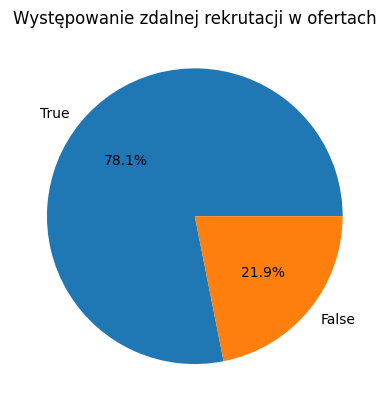

In [117]:
# Generowanie wykresu kołowego
plt.pie(remoteinterview_percentage, labels=remoteinterview_percentage.index, autopct='%1.1f%%', startangle=0)
plt.title('Występowanie zdalnej rekrutacji w ofertach')
plt.show()

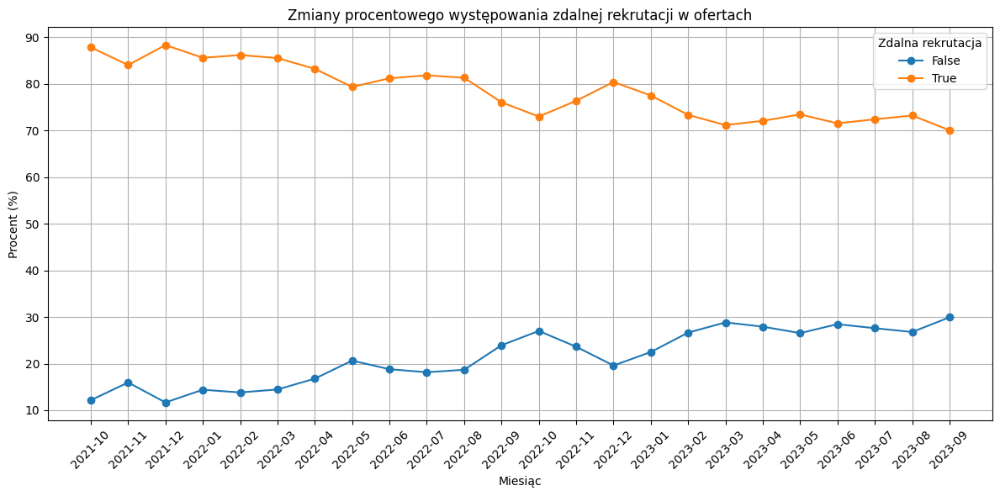

In [ ]:
# Przygotowanie danych do wykresu zmian w czasie
# Pominięcie pierwszego "szczątkowego" miesiąca - 2021-09
df_filtered = df[df['year_month'] != '2021-09']
# Zliczenie rodzajów rekrutacji w miesiącach
grouped = df_filtered.groupby([df_filtered['year_month'], 'remote_interview']).size().unstack(fill_value=0)
# Obliczanie procentów
percentages = grouped.div(grouped.sum(axis=1), axis=0) * 100

# Generowanie wykresu
plt.figure(figsize=(12, 6))
for col in percentages.columns:
    plt.plot(percentages.index.astype(str), percentages[col], label=col, marker='o')
plt.xlabel('Miesiąc')
plt.ylabel('Procent (%)')
plt.title('Zmiany procentowego występowania zdalnej rekrutacji w ofertach')
plt.legend(title='Zdalna rekrutacja')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

#### Wnioski
* W znaczącej wiekszości ofert - 78% występuje zdalna rekrutacja
* W analizowanym okresie widoczny jest spadek występowania zdalnej rekrutacji w ofertach z prawie 90% do 70%

#### J. Oferty dla Ukraińców

In [119]:
# Sprawdzenie kiedy pojawiła się pierwsza oferta z wartością w kolumnie 'open_to_hire_ukrainians'
df_ukrainians = df[df['open_to_hire_ukrainians'].isin([0, 1])]
df_ukrainians['published_at'].min()

Timestamp('2022-02-13 16:49:00')

In [120]:
# Filtrowanie, aby pozostały tylko wiersze, w których 'open_to_hire_ukrainians' nie jest None (0 lub 1)
df_ukrainians = df[df['open_to_hire_ukrainians'] == 1]
# Sortowanie według daty 'published_at' (od najstarszej)
df_ukrainians.sort_values(by='published_at')

title                 street  \
34339        SOFTWARE TESTER [WEBAPP & MOBILE]           Józefitów  8   
36169                       Manual QA Engineer  Tryton Business House   
36179   Mid/Senior Backend Developer (Node.js)          Nowy Świat 35   
36322                       Manual QA Engineer                Centrum   
36327                Junior Frontend Developer          ul. Szafarnia   
...                                        ...                    ...   
348764     Full stack Mid/Sr Magento Developer                centrum   
348765                      Frontend Developer                Centrum   
348766     Full stack Mid/Sr Magento Developer                centrum   
348770                     Fullstack Developer         Kołobrzeska 14   
348778                             QA Engineer    aleje jerozolimskie   

            city country_code                   address_text marker_icon  \
34339     Kraków           PL           Józefitów  8, Kraków     testing   
36169     Gdańsk           PL  Tryton Business House, Gdańsk     testing   
36179   Warszawa           PL        Nowy Świat 35, Warszawa  javascript   
36322   Warszawa           PL              Centrum, Warszawa     testing   
36327     Gdańsk           PL          ul. Szafarnia, Gdańsk  javascript   
...          ...          ...                            ...         ...   
348764    Gdynia           PL                centrum, Gdynia         php   
348765   Wrocław           PL               Centrum, Wrocław  javascript   
348766     Sopot           PL                 centrum, Sopot         php   
348770    Gdańsk           PL         Kołobrzeska 14, Gdańsk  javascript   
348778  Warszawa           PL  aleje jerozolimskie, Warszawa     testing   

       workplace_type            company_name company_size experience_level  \
34339          remote         Dev and Deliver        30-40              mid   
36169          remote                 Ciklum           200              mid   
36179          remote                SwingDev        11-50           senior   
36322          remote                 Ciklum           200              mid   
36327   partly_remote         SUNZINET Polska          140           junior   
...               ...                     ...          ...              ...   
348764  partly_remote  InterLogic Danmark ApS         300+           senior   
348765         remote                Pragmile          80+           senior   
348766  partly_remote  InterLogic Danmark ApS         300+              mid   
348770         remote             DAC.digital         120+              mid   
348778         remote                   Onoco         5-10              mid   

              published_at  remote_interview  \
34339  2022-02-16 08:25:00              True   
36169  2022-02-21 10:14:00              True   
36179  2022-02-21 10:24:00              True   
36322  2022-02-21 12:26:00              True   
36327  2022-02-21 12:30:00              True   
...                    ...               ...   
348764 2023-09-25 14:45:00              True   
348765 2023-09-25 14:45:00              True   
348766 2023-09-25 14:46:00              True   
348770 2023-09-25 15:00:11              True   
348778 2023-09-25 16:44:18              True   

                                         employment_types  \
34339   [{'type': 'b2b', 'salary': {'from': 4500, 'to'...   
36169   [{'type': 'permanent', 'salary': None}, {'type...   
36179   [{'type': 'permanent', 'salary': {'from': 1600...   
36322   [{'type': 'b2b', 'salary': None}, {'type': 'pe...   
36327   [{'type': 'b2b', 'salary': {'from': 5500, 'to'...   
...                                                   ...   
348764  [{'type': 'b2b', 'salary': {'from': 4000, 'to'...   
348765  [{'type': 'b2b', 'salary': {'from': 20000, 'to...   
348766  [{'type': 'b2b', 'salary': {'from': 4000, 'to'...   
348770  [{'type': 'b2b', 'salary': {'from': 21000, 'to...   
348778  [{'type': 'b2b', 'salary': {'from': 7000, 'to'

In [121]:
# Liczba ofert dla Ukraińców w każdym miesiącu
monthly_true_count = df[df['open_to_hire_ukrainians'] == True].groupby('year_month').size()
# Liczba wszystkich ofert w każdym miesiącu
monthly_total_count = df.groupby('year_month').size()
# Obliczenie procentu ofert dla Ukraińców
monthly_true_percentage = (monthly_true_count / monthly_total_count) * 100
# Generowanie wykresu liniowego
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=monthly_true_percentage.index.astype(str),
    y=monthly_true_percentage,
    mode='lines+markers',
    name='Oferty dla Ukraińców',
    line=dict(color='green')
))
# Dodanie pionowej linii dla lutego 2022
fig.add_shape(
    type="line",
    x0="2022-02", x1="2022-02",
    y0=0, y1=monthly_true_percentage.max(),  
    line=dict(color="red", width=2, dash="dash")
)
# Dodanie adnotacji
fig.add_annotation(
    x="2022-02",
    y=monthly_true_percentage.max(),
    text="Początek wojny na Ukrainie",
    showarrow=True,
    arrowhead=2,
    ax=0, ay=-30,
    font=dict(color="red", size=14)
)
fig.update_layout(
    title="Udział procentowy ofert pracy dla Ukraińców",
    xaxis_title="Miesiąc",
    yaxis_title="Procent (%)",
    template="plotly",
    showlegend=True
)
fig.show()


#### Wnioski
* Dane w kolumnie 'open_to_hire_ukrainians' pojawiają się pierwszy raz 13 lutego 2022 roku (11 dni przed rozpoczęciem wojny)
* Pierwsza oferta pracy skierowana dla Ukraińców pojawiaja się już 16 lutego 2022 roku
* Od 21 lutego 2022 roku pojawia wiele ofert pracy dla Ukraińców
* Po rozpoczęciu wojny na Ukrainie połowa ofert była skierowana do Ukraińców, wartość ta spadła do 26% we wrześniu 2023 roku     

#### K. Wynagrodzenia

In [122]:
# Konwertowanie stringa w 'employment_types' na listę
df['employment_types'] = df['employment_types'].apply(ast.literal_eval)

In [123]:
# Funkcja do rozdzielania danych na kolumny
def extract_salary_info(data):
    result = {}
    
    for i, entry in enumerate(data):
        suffix = f"_{i+1}"  # Dodawanie numeru (np. _1, _2)
        result[f"type{suffix}"] = entry.get('type', None)
        salary = entry.get('salary', None)
        if salary:
            result[f"salary_from{suffix}"] = salary.get('from', None)
            result[f"salary_to{suffix}"] = salary.get('to', None)
            result[f"currency{suffix}"] = salary.get('currency', None)
        else:
            result[f"salary_from{suffix}"] = None
            result[f"salary_to{suffix}"] = None
            result[f"currency{suffix}"] = None
    
    return pd.Series(result)

# Zastosowanie funkcji na kolumnie 'employment_types'
df_new = df["employment_types"].apply(extract_salary_info)

# Połączenie nowych kolumn z DF
df = pd.concat([df, df_new], axis=1)

In [124]:
# Kursy walut
exchange_rates = {
    'gbp': 5.3,
    'chf': 4.6,
    'usd': 4.4,
    'eur': 4.6
}

# Funkcja przeliczająca wynagrodzenia na PLN
def convert_to_pln(row, salary_from_col, salary_to_col, currency_col):
    currency = row[currency_col]
    rate = exchange_rates.get(currency, 1)  # domyślny kurs 1, jeśli waluta nie jest w słowniku
    salary_from_pln = row[salary_from_col] * rate
    salary_to_pln = row[salary_to_col] * rate
    return pd.Series([salary_from_pln, salary_to_pln])

# Przeliczenie dla '1' i '2' na PLN
df[['salary_from_1_pln', 'salary_to_1_pln']] = df.apply(convert_to_pln, axis=1, salary_from_col='salary_from_1', salary_to_col='salary_to_1', currency_col='currency_1')
df[['salary_from_2_pln', 'salary_to_2_pln']] = df.apply(convert_to_pln, axis=1, salary_from_col='salary_from_2', salary_to_col='salary_to_2', currency_col='currency_2')

# Usuwanie niepotrzebnych kolumn
df = df.drop(columns=['employment_types', 'currency_1', 'currency_2', 'salary_from_1', 'salary_from_2', 'salary_to_1', 'salary_to_2'])

In [125]:
# Generowanie wykresu boxplot
fig = px.box(df, x="salary_to_1_pln", orientation='h',)
fig.update_layout(width=1200, height=200, title="Rozkład górnej granicy wynagrodzenia w ofertach", xaxis_title="Wynagrodzenie w PLN")
fig.show()

In [126]:
# Funkcja do obliczenia średniego wynagrodzenia
def calculate_average(row):
    values = []
    
    if not pd.isna(row['salary_from_1_pln']) and not pd.isna(row['salary_to_1_pln']):
        values.append((row['salary_from_1_pln'] + row['salary_to_1_pln']) / 2)
    
    if not pd.isna(row['salary_from_2_pln']) and not pd.isna(row['salary_to_2_pln']):
        values.append((row['salary_from_2_pln'] + row['salary_to_2_pln']) / 2)
    
    # Jeżeli są jakiekolwiek wartości, liczy średnią
    if values:
        return sum(values) / len(values)
    else:
        return None

# Zastosowanie funkcji do każdej z linii w DataFrame
df['average_salary'] = df.apply(calculate_average, axis=1)

In [127]:
# Generowanie wykresu boxplot
fig = px.box(df, x="average_salary", orientation='h',)
fig.update_layout(width=1200, height=200, title="Rozkład średniego wynagrodzenia w ofertach", xaxis_title="Wynagrodzenie w PLN")
fig.show()

In [ ]:
# Podstawowa analiza statystyczna średniego wynagrodzenia
df['average_salary'].describe()

count    215267.000000
mean      19190.054614
std       10224.036551
min         250.000000
25%       13800.000000
50%       18500.000000
75%       23480.000000
max      594000.000000
Name: average_salary, dtype: float64

In [ ]:
# Utworzenie kopii df do przygotowania wykresu
test_df = df.copy()
# Odsianie ekstremalnych wartośći odstających
test_df = test_df[test_df['average_salary'] < 80_000]
# Dodanie kolumny 'month' z miesiącem w formacie YYYY-MM jako string
test_df['month'] = test_df['year_month'].dt.strftime('%Y-%m')
# Filtrowanie danych, aby usunąć pierwszy miesiąc
test_df = test_df[test_df['month'] != '2021-09']
# Generowanie wykresu boxplot
fig = px.box(test_df, x='month', y='average_salary', 
             title='Zmiany rozkładu średniego wynagrodzenia w ofertach do 80.000 PLN miesięcznie',
             labels={'month': 'Miesiąc', 'average_salary': 'Wynagrodzenie w PLN'})
fig.update_xaxes(tickangle=-45)  
fig.update_layout(height=700)
fig.show()

#### Wnioski
* 2/3 ofert zawiera dane o wynagrodzeniach 215 tyś. ofert z 300 tyś.
* Dane o wynagrodzeniach zawierają dużo wartości odstających, gdzie miesięczne wynagrodzenia dochodzą do kilkuset tysięcy PLN
* Mediana i średnia wartość średniego wynagrodzenia we wszystkich ofertach wynosi około 16 tyś. PLN
* W analizowanym okresie poziom wynagrodzeń wzrastał przez pierwsze 18 miesięcy, po czym się ustabilizował (mediany)
* W analizowanych miesiącach mediana średniego wynagrodzenia wzrosła z 15 tyś. do 20 tyś. PLN

#### L. Typ umowy 

In [130]:
# Lista typów umowy
types_of_employment = ['permanent', 'b2b', 'mandate_contract']

# Utworzenie kolumn dla kazdego typu umowy i wypełnienie ich wartościami 1 lub 0
for t in types_of_employment:
    df[t] = ((df['type_1'] == t) | (df['type_2'] == t)).astype(int)

In [131]:
# Obliczenie procentu wystąpień poszczególnych typów umów
percentages = df[types_of_employment].mean() * 100

# Utworzenie wynikowego DataFrame
result_df = pd.DataFrame(percentages).reset_index()
result_df.columns = ['Typ umowy', 'Procent']
result_df

Typ umowy    Procent
0         permanent  57.525117
1               b2b  68.565954
2  mandate_contract   1.778770

In [ ]:

# Obliczenie procentu wystąpień poszczególnych typów umów w miesiącach
percentages = df.groupby(df['year_month'])[['permanent', 'b2b', 'mandate_contract']].apply(lambda x: (x == 1).mean() * 100).reset_index()
# Konwersja 'year_month' na string
percentages['year_month'] = percentages['year_month'].astype(str)

legend_labels = {
    'permanent': 'Umowa o pracę',
    'b2b': 'B2B',
    'mandate_contract': 'Umowa zlecenie'
}
# Generowanie wykresu
fig = px.line(percentages, x='year_month', y=['permanent', 'b2b', 'mandate_contract'],
              labels={'year_month': 'Miesiąc', 'value': 'Procent ofert'},
              title='Zmiany udziału typów umów w ofertach',
              markers=True)
fig.update_layout(legend_title='Rodzaj umowy')
# Zaktualizowanie nazw w legendzie za pomocą pętli i słownika
for col, label in legend_labels.items():
    fig.update_traces(
        name=label, 
        selector=dict(name=col),
        mode='lines+markers')
fig.show()

#### Wnioski
* W ofertach występują 3 typy umów. Najczęściej B2B - 68%, umowa o pracę - 57%, umowa zlecenie - prawie 2%
* Wiele ofert dopuszcza dwa różne rodzaje typów umów
* W analizowanym okresie zmniejszało się występowanie umów o pracę z 73% do 62%
* Wystepowanie w ofertach umów B2B zwiększało się z 53% do 61%
* Częstość występowania w ofertach umów zlececenia jest mniejwięcej stała i waha się w zakresie 1-3% 

#### M. Wymagane kompetencje

In [133]:
# Konwertowanie stringa w 'skills' na listę
df['skills'] = df['skills'].apply(ast.literal_eval)

In [134]:
# Utworzenie listy wszystkich kompetencji
skills = pd.Series(df['skills'].explode().apply(lambda x: x['name']))
# Sprawdzanie liczby unikatowych kompetencji
print(len((skills).unique()))

11203


In [135]:

# Utworzenie DataFrame ze wszystkimi kompetencjami w kolumnie 'skills'
skills_df = pd.DataFrame(skills, columns=['skills'])
# Sprawdzenie częstości powtarzania się kompetencji
skills_count_df = skills_df['skills'].value_counts().reset_index()
skills_count_df.columns = ['kompetencje', 'liczba']
skills_count_df

kompetencje  liczba
0                JavaScript   32975
1                      Java   32933
2                   English   28068
3                       SQL   26717
4                    Python   25206
...                     ...     ...
11198                CodeQL       1
11199        Articulate 360       1
11200  Deep Neural Networks       1
11201          ARM assembly       1
11202     Quantum computing       1

[11203 rows x 2 columns]

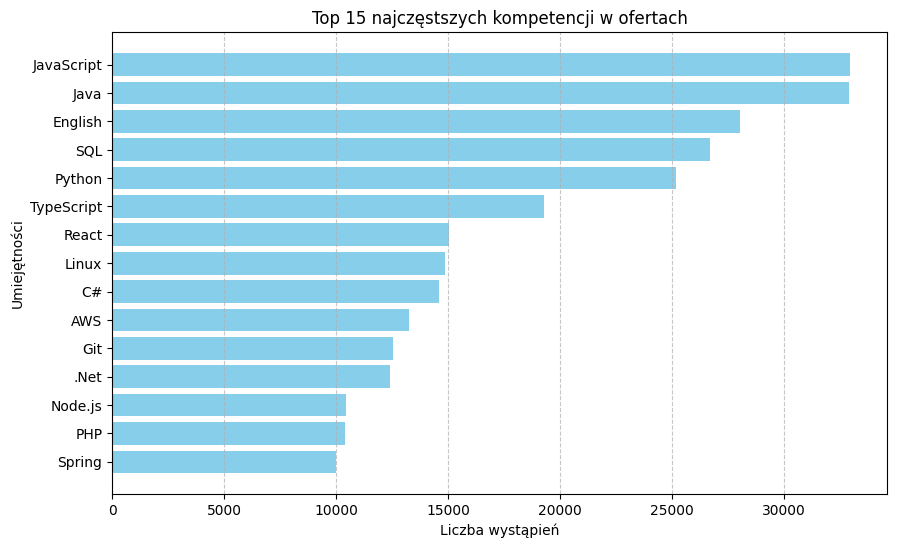

In [ ]:
top_15_skills = skills_count_df.head(15)

# Generowanie wykresu słupkowego w poziomie dla TOP 15
plt.figure(figsize=(10, 6))
plt.barh(top_15_skills['kompetencje'], top_15_skills['liczba'], color='skyblue')
plt.xlabel('Liczba wystąpień')
plt.ylabel('Umiejętności')
plt.title('Top 15 najczęstszych kompetencji w ofertach')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
# Inwersja osi y, aby najwyższy słupek był na górze
plt.gca().invert_yaxis()
plt.show()

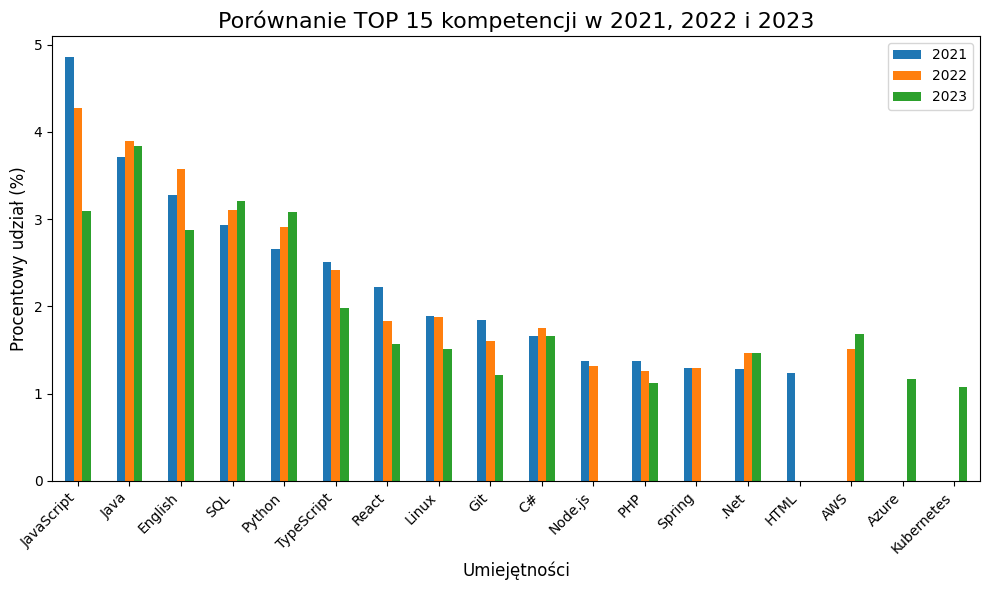

In [ ]:
# Zmiany w TOP 15 kompetencji
# Utworzenie kopii DF
df_exploded = df.copy()
# Ekspandowanie kolumny 'skills'
df_exploded = df_exploded.explode('skills')
# Ekstrakcja nazw kompetencji
df_exploded['skill_name'] = df_exploded['skills'].apply(lambda x: x['name'])
# Utworzenie kolumny 'year'
df_exploded['year'] = df_exploded['published_at'].dt.year
# Zliczanie kompetencji w roku
skill_counts = df_exploded.groupby(['year', 'skill_name']).size().reset_index(name='count')
# Obliczenie procentowego udziału kompetencji dla każdego roku
total_counts = skill_counts.groupby('year')['count'].transform('sum')
skill_counts['percentage'] = (skill_counts['count'] / total_counts) * 100
# Wybór top 10 umiejętności na każdy rok
top_10_by_year = skill_counts.sort_values('count', ascending=False).groupby('year').head(15).reset_index(drop=True)
# Utworzenie DataFrame do wykresu
top_10_df = top_10_by_year.pivot_table(index='skill_name', columns='year', values='percentage', aggfunc='max').fillna(0)
# Sortowanie danych według 2021 roku
top_10_df = top_10_df.sort_values(by=2021, ascending=False)

# Generowanie wykresu słupkowego
ax = top_10_df.plot(kind='bar', figsize=(10, 6), color=['#1f77b4', '#ff7f0e', '#2ca02c'])
ax.set_title('Porównanie TOP 15 kompetencji w 2021, 2022 i 2023', fontsize=16)
ax.set_xlabel('Umiejętności', fontsize=12)
ax.set_ylabel('Procentowy udział (%)', fontsize=12)
ax.set_xticklabels(top_10_df.index, rotation=45, ha='right')
ax.legend(title=None)
plt.tight_layout()
plt.show()


#### Wnioski
* W analizowanych ofertach wymienione zostały 11.203 unikatowe kompetencje
* Do najczęściej poszukiwanych kompetencji należą: JavaScript, Java, English, SQL i Python
* Analizując w kolejnych latach TOP 15 najczęściej występujących kompetencji można stwierdzić, że:
    * Większość z najczęściej wymienianych występuje w ofertach coraz rzadziej, głównie JavaScript, TypeScript i React
    * Kompetencje coraz częściej poszukiwane, to SQL, Python, .Net, AWS, Azure i Kubernetes


## 6. Analiza relacji między zmiennymi - pytania

### A. Jak wpływa poziom doświadczenia na średnie wynagrodzenie

In [138]:
# Grupowanie po poziomie doświadczenia i opis statystyczny dla średniego wynagrodzenia
(df.groupby('experience_level')['average_salary']).describe()

count          mean           std     min      25%  \
experience_level                                                          
junior             14260.0   8055.369821   3727.578357  1000.0   6000.0   
mid               109192.0  16532.745532   7383.313627   950.0  12500.0   
senior             91815.0  24079.642354  11248.608738   250.0  19500.0   

                      50%      75%       max  
experience_level                              
junior             7350.0   9000.0   81000.0  
mid               15550.0  19500.0  391000.0  
senior            22900.0  27300.0  594000.0

In [ ]:
# Generowanie wykresu pudełkowego
# Utworzenie kolumny 'year'
df['year'] = df['published_at'].dt.year
# Utworzenie kopii DF
df_box = df.copy()
# Wybór ofert ze średnim wynagrodzeniem do 80.000 PLN
df_box = df_box[df_box['average_salary'] < 80_000]
# Kolory dla boxplotów
color_map = {
    'junior': 'royalblue',
    'mid': 'tomato',
    'senior': 'green'
}
fig_junior = px.box(df_box[df_box['experience_level'] == 'junior'], 
                    y='year', x='average_salary', 
                    title='Średnie wynagrodzenie w ofertach dla poziomu Junior', 
                    orientation='h', 
                    color='experience_level', 
                    color_discrete_map=color_map)

fig_mid = px.box(df_box[df_box['experience_level'] == 'mid'], 
                 y='year', x='average_salary', 
                 title='Średnie wynagrodzenie w ofertach dla poziomu Mid', 
                 orientation='h', 
                 color='experience_level', 
                 color_discrete_map=color_map)

fig_senior = px.box(df_box[df_box['experience_level'] == 'senior'], 
                    y='year', x='average_salary', 
                    title='Średnie wynagrodzenie w ofertach dla poziomu Senior', 
                    orientation='h', 
                    color='experience_level', 
                    color_discrete_map=color_map)

for fig in [fig_junior, fig_mid, fig_senior]:
    fig.update_layout(
        xaxis=dict(
            tickmode='linear',
            dtick=5000, 
            showgrid=True,  
            gridwidth=1,  
            gridcolor='gray',  
        ),
        xaxis_title='Średnie wynagrodzenie w PLN',
        yaxis_title='Rok',
        showlegend=False,
        height=300
    )
# Wyświetlanie wykresów
fig_junior.show()
fig_mid.show()
fig_senior.show()


#### Wnioski
* Poziom doświadczenia ma wyraźny wpływ na oferowane średnie zarobki
* Średnie zarobki na poziomie mid (16.000 PLN), są dwukrotnie wyższe niż na poziomie junior (ok. 8.000 PLN)
* Średnie zarobki na poziomie senior (24.000 PLN), są trzykrotnie wyższe niż na poziomie junior (ok. 8.000 PLN)
* W analizowanym okresie poziom zarobków wzrastał podobnie we ofertach wszystkich trzech poziomów doświadczenia

### B. Jak wpływa wielkość firmy na średnie wynagrodzenie

In [145]:
# Przygotowanie danych
df_box = df_box[df_box['company_class'] != "Inne"]
# Określenie dokładnej kolejności kategorii
category_order = ['Małe','Średnie','Duże','Wielkie']

# Generowanie wykresu pudełkowego
fig = px.box(df_box, x='average_salary', y='company_class',
             title="Rozkład zarobków w zależności od wielkości firmy",
             labels={'company_class': 'Wielkość firmy', 'average_salary': 'Średnie zarobki w PLN'},
             orientation='h', color='company_class', category_orders={'company_class': category_order})

legend_labels = {
    'Małe': 'Małe <10',
    'Średnie': 'Średnie 10-100',
    'Duże': 'Duże 100-1000',
    'Wielkie': 'Wielkie > 1000'
}
# Zaktualizowanie legendy z niestandardowymi etykietami
fig.for_each_trace(lambda t: t.update(name=legend_labels.get(t.name, t.name)))

fig.update_layout(
    showlegend=True,  
    legend_title="Ilość pracowników:", 
    legend=dict(x=1, y=1, traceorder='normal', orientation='v')
)
fig.show()


#### Wnioski
* Średnie wynagrodzenie proponowane w ofertach w małym stopniu zależy od wielkości firmy
* Firmy małe i średnie, czyli zatrudniające poniżej 100 pracowników oferują średnie zarobki nieco niższe niż firmy większe

### C. Jaka jest korelacja pomiędzy kompetencjami a średnim wynagrodzeniem

In [147]:
skills_count_df

kompetencje  liczba
0                JavaScript   32975
1                      Java   32933
2                   English   28068
3                       SQL   26717
4                    Python   25206
...                     ...     ...
11198                CodeQL       1
11199        Articulate 360       1
11200  Deep Neural Networks       1
11201          ARM assembly       1
11202     Quantum computing       1

[11203 rows x 2 columns]

In [154]:
# Wybór 20 najczęstszych kompetencji
top_20_df = skills_count_df.head(20)
# Utworzenie listy 20 najczęstszych kompetencji:
top_20_skills = top_20_df['kompetencje'].tolist()

In [167]:
# Utworzenie DataFrame tylko z kolumnami 'skills' i 'average_salary'
top_Skills_df = df[['skills', 'average_salary']].reset_index()
# Dodanie kolumn dla każdej z 20 najczęstszych kompetecji i wypełnienie wartościami 0
top_Skills_df[top_20_skills] = 0
# Wypełnienie kolumn wartościami 1,tam gdzie wystepuje dana kompetencja
for skill in top_20_skills:
    top_Skills_df[skill] = top_Skills_df['skills'].apply(lambda x: 1 if any(d['name'] == skill for d in x) else 0)




In [168]:
top_Skills_df

index                                             skills  \
0            0  [{'name': 'TypeScript', 'level': 3}, {'name': ...   
1            1                    [{'name': 'PHP 7', 'level': 4}]   
2            2  [{'name': 'SASS', 'level': 4}, {'name': 'Vue.j...   
3            3  [{'name': 'Laravel', 'level': 4}, {'name': 'Ba...   
4            4                    [{'name': 'PHP 7', 'level': 4}]   
...        ...                                                ...   
300090  348774  [{'name': 'Agile/Scrum', 'level': 3}, {'name':...   
300091  348775  [{'name': 'Quantum AI', 'level': 4}, {'name': ...   
300092  348776  [{'name': 'JS', 'level': 1}, {'name': 'Elixir'...   
300093  348777  [{'name': 'Cucumber', 'level': 3}, {'name': 'T...   
300094  348778  [{'name': 'JIRA', 'level': 1}, {'name': 'Postm...   

        average_salary  JavaScript  Java  English  SQL  Python  TypeScript  \
0              15000.0           0     0        0    0       0           1   
1                  NaN           0     0        0    0       0           0   
2              16000.0           0     0        0    0       0           0   
3              18000.0           0     0        0    0       0           0   
4                  NaN           0     0        0    0       0           0   
...                ...         ...   ...      ...  ...     ...         ...   
300090         14500.0           0     0        1    0       0           0   
300091         17500.0           0     0        0    0       0           0   
300092         20000.0           0     0        0    0       1           0   
300093         26880.0           0     1        0    0       0           0   
300094          9000.0           0     0        0    0       0           0   

        React  ...  Git  .Net  Node.js  PHP  Spring  Angular  Docker  C++  \
0           1  ...    0     0        0    0       0        0       0    0   
1           0  ...    0     0        0    0       0        0       0    0   
2           0  ...    0     0        0    0       0        0       0    0   
3           0  ...    0     0        0    1       0        0       0    0   
4           0  ...    0     0        0    0       0        0       0    0   
...       ...  ...  ...   ...      ...  ...     ...      ...     ...  ...   
300090      0  ...    0     0        0    0       0        0       0    0   
300091      0  ...    0     0        0    0       0        0       0    0   
300092      0  ...    0     0        0    0       0        0       0    0   
300093      0  ...    0     0        0    0       0        0       0    0   
300094      0  ...    0     0        0    0       0        0       0    0   

        Kubernetes  Azure  
0                0      0  
1                0      0  
2                0      0  
3                0      0  
4                0      0  
...            ...    ...  
300090           0      0  
300091           0      0  
300092           0      0  
300093           0      0  
300094           0      0  

[300095 rows x 23 columns]

In [179]:
# Usunięcie niepotrzebnych kolumn
top_Skills_df = top_Skills_df.drop(columns=['skills', 'index'])

In [180]:
# Obliczenie macierzy korelacji
corr_matrix = top_Skills_df.corr()
# Wybranie korelacji tylko dla średniego wynagrodzenia i posortowanie
correlations = corr_matrix['average_salary'].sort_values(ascending=False)

# Usunięcie korelacji wynagrodzenia ze sobą
top_corelation = correlations[1:]
# Pokazanie 10 najsilniejszych pozytywnych korelacji
top_corelation.head(10) 


AWS           0.125498
Kubernetes    0.079481
Python        0.072823
Azure         0.057205
TypeScript    0.054254
Java          0.052441
Node.js       0.051490
React         0.035934
Spring        0.022403
Docker        0.019435
Name: average_salary, dtype: float64

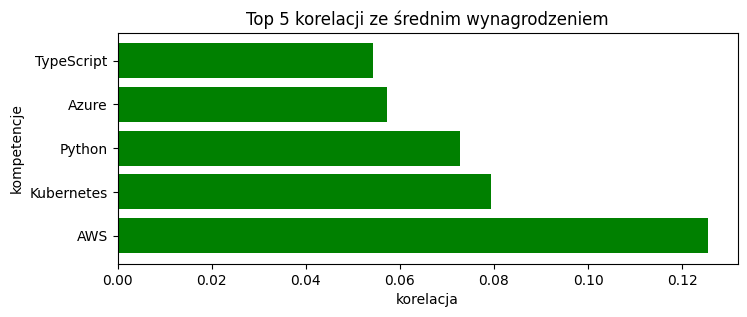

In [181]:
# Wybór 5 najsilniejszych korelacji
top5_corelation = top_corelation.head(5)

# Generowanie wykresu poziomego
plt.figure(figsize=(8, 3))
plt.barh(top5_corelation.index, top5_corelation.values, color='green')
plt.title('Top 5 korelacji ze średnim wynagrodzeniem')
plt.xlabel('korelacja')
plt.ylabel('kompetencje')
plt.show()


#### Wnioski
* Korelacje pomiędzy poszczególnymi kompetencjami a średnim wynagrodzeniem nie są silne
* Najsilniejsze pozytywne korelacje mają AWS, Kubernetes, Python, React, Azure i TypeScript

## 7. Wnioski końcowe
### Oferty
* Przeanalizowano ponad 8 milionów ofert pracy opublikowanych na platformie Justjoin.it
* Oferty pochodziły z okresu od września 2021 roku do września 2023 roku
* Po usunięciu duplikatów i powtórnie publikowanych ofert pozostało 300.095 unikatowych ogłoszeń
* Przed wybuchem wojny na Ukrainie miesięczna liczba ofert wynosiła 5-8 tysięcy, a po jej rozpoczęciu wzrosła do 9-17 tysięcy
  
### Miejsca pracy
* Większość ofert pracy dotyczy dużych miast, takich jak Warszawa, Kraków, Wrocław i Poznań
* Udział ofert z tych czterech miast spada na rzecz Gdańska, Katowic, Łodzi i Lublina
* Aż 97% ofert pochodzi z Polski
* Wśród ofert zagranicznych najwięcej pochodzi z Niemiec, Wielkiej Brytanii i USA
* Coraz bardziej widoczny staje się wzrost liczby ofert z Rumunii, Węgier i Portugalii

### Pracodawcy i pracownicy
* Coraz więcej ofert pracy pochodzi od dużych i bardzo dużych firm, zatrudniających ponad 100 pracowników (możliwa konsolidacja rynku?)
* Najczęściej poszukiwanymi zawodami są: Java Developer, Frontend Developer i DevOps Engineer (ten zawód staje się coraz bardziej popularny)
* Praca zdalna lub częściowo zdalna pozostaje najczęściej oferowaną formą zatrudnienia, i ta tendencja utrzymuje się
* Udział ofert pracy na poziomie Senior rośnie, podczas gdy dla poziomów Junior i Mid maleje
* Chociaż popularność zdalnej rekrutacji zmniejsza się, to wciąż występuje dwukrotnie częściej niż rekrutacja stacjonarna
* Pracodawcy stopniowo rezygnują z umów B2B, coraz częściej oferując umowy o pracę

### Kompetencje i wynagrodzenia
* Do najczęściej poszukiwanych kompetencji należą: JavaScript, Java, język angielski, SQL i Python
* Wzrost zapotrzebowania obserwuje się wśród kompetencji związanych z: SQL, Python, .Net, AWS, Azure oraz Kubernetes
* Najlepiej opłacane kompetencje to: AWS, Kubernetes i Python, choć korelacja między wynagrodzeniem a tymi umiejętnościami jest dość słaba
* Wynagrodzenia są silnie uzależnione od poziomu doświadczenia
* Średnie wynagrodzenie oferowane dla poszczególnych poziomów doświadczenia wynosi:
    * Junior – 8 tys. zł
    * Mid – 16 tys. zł
    * Senior – 24 tys. zł

### Wojna na Ukrainie
* Po wybuchu wojny na Ukrainie połowa ofert była skierowana do Ukraińców, wartość ta spadła o połowę do września 2023 roku 
* Wydaje się, że rynek pracodawców IT doskonale przewidział wybuch konfliktu na Ukrainie:
    * Kategoria "oferty dla Ukraińców" została wprowadzona 13 lutego 2022 roku (11 dni przed rozpoczęciem wojny)
    * Pierwsza oferta pracy skierowana dla Ukraińców pojawiła się 16 lutego 2022 roku (8 dni przed rozpoczęciem wojny)
    * Od 21 lutego 2022 roku zaczęły pojawiać się liczne oferty pracy dla Ukraińców (3 dni przed rozpoczęciem wojny)

